Q2

In [ ]:

from PIL import Image, ImageFilter
 
img = Image.open(r"/content/q2.jpg")
 
# Converting the image to grayscale, as Sobel Operator requires
# input image to be of mode Grayscale (L)
img = img.convert("L")
 
# Calculating Edges using the passed laplacian Kernel
laplacian = img.filter(ImageFilter.Kernel((3, 3), (-1, -1, -1, -1, 8, -1, -1, -1, -1), 1, 0))
laplacian.save("laplacian.png")
# Calculating Edges using the passed sober Gy Kernel
sober_Gy = img.filter(ImageFilter.Kernel((3, 3), (1, 2, 1, 0,0,0,-1,-2,-1), 1, 0))
sober_Gy.save("sober_Gy.png")
# Calculating Edges using the passed sober Gx Kernel
sober_Gx = img.filter(ImageFilter.Kernel((3, 3), (-1, 0, 1, -2,0,2,-1,0,1), 1, 0))
sober_Gx.save("sober_Gx.png")

prewitt_Gy = img.filter(ImageFilter.Kernel((3, 3), (1, 1, 1, 0,0,0,-1,-1,-1), 1, 0))
prewitt_Gy.save("prewitt_Gy.png")
# Calculating Edges using the passed prewitt Gx Kernel
prewitt_Gx = img.filter(ImageFilter.Kernel((3, 3), (-1, 0, 1, -1,0,1,-1,0,1), 1, 0))
prewitt_Gx.save("prewitt_Gx.png")

Q3

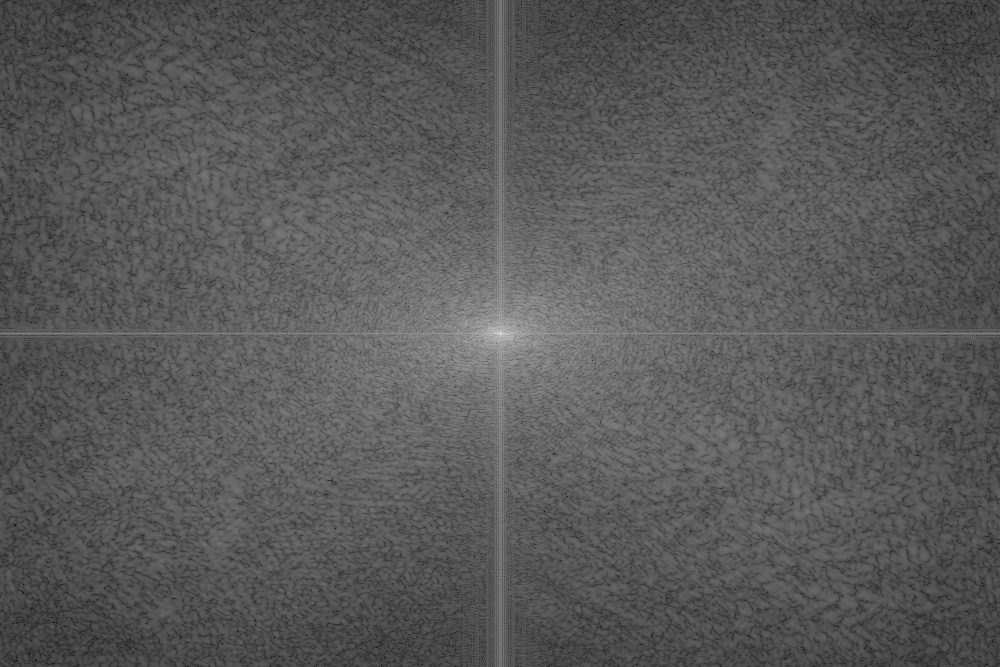

In [14]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
# now we will be loading the image and converting it to grayscale
image = cv2.imread(r"dog.jpg")
 
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
 
# Compute the discrete Fourier Transform of the image
fourier = cv2.dft(np.float32(gray), flags=cv2.DFT_COMPLEX_OUTPUT)
 
# Shift the zero-frequency component to the center of the spectrum
fourier_shift = np.fft.fftshift(fourier)
 
# calculate the magnitude of the Fourier Transform
magnitude = 20*np.log(cv2.magnitude(fourier_shift[:,:,0],fourier_shift[:,:,1]))
 
# Scale the magnitude for display
magnitude = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8UC1)
 
# Display the magnitude of the Fourier Transform
cv2_imshow(magnitude)

Q4

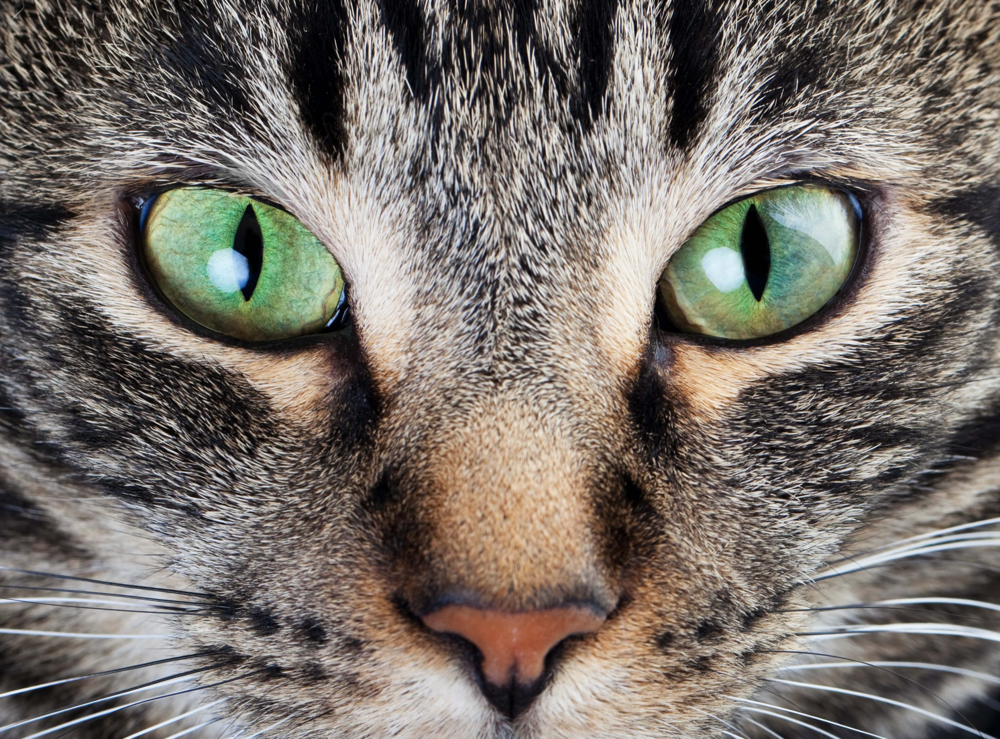

In [ ]:
from google.colab.patches import cv2_imshow 
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img = cv.imread('cat.jpeg')
cv2_imshow(img)



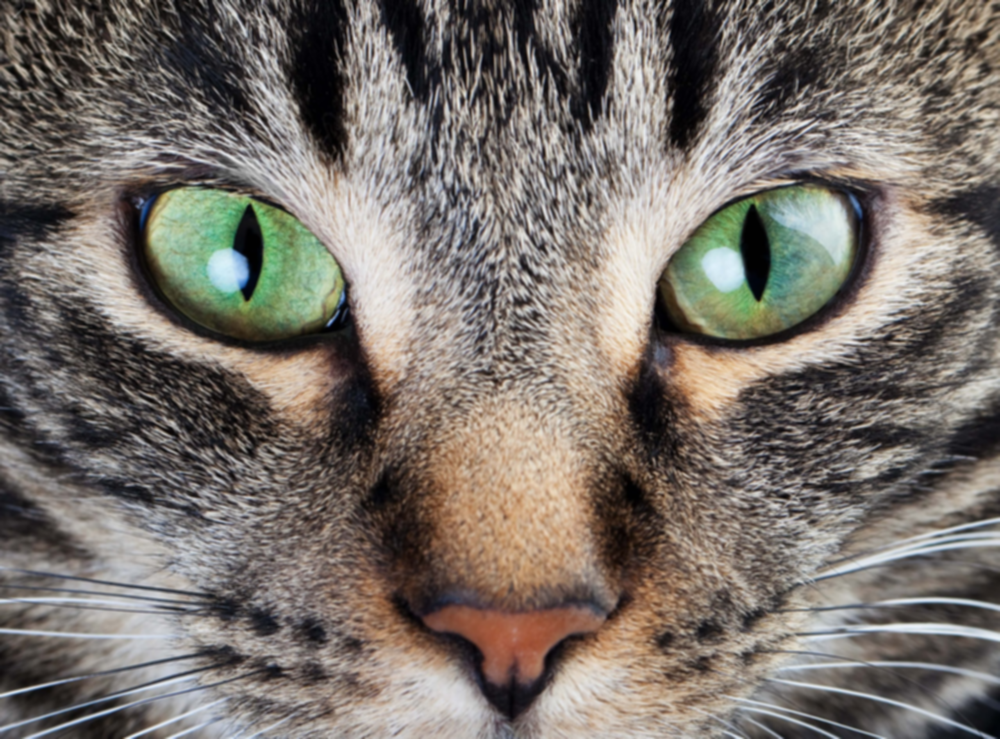

In [ ]:
# GaussianBlur
blur = cv.GaussianBlur(img,(9,9),3)
cv2_imshow(blur)


In [ ]:
from skimage.measure import block_reduce
mean_pool=block_reduce(img, block_size=(9,9,1), func=np.mean)
max_pool=block_reduce(img, block_size=(9,9,1), func=np.max)
min_pool=block_reduce(img, block_size=(9,9,1), func=np.min)





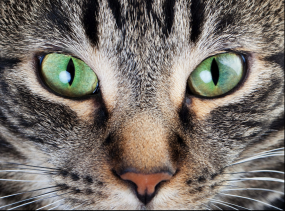

In [ ]:
# average with skimage
cv2_imshow(mean_pool)


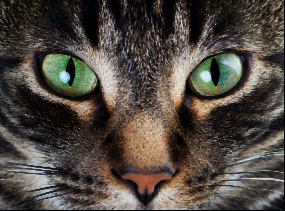

In [ ]:
# min with skimage
cv2_imshow(min_pool)

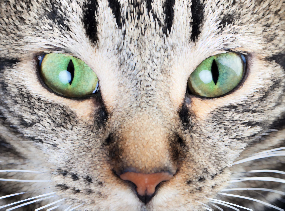

In [ ]:
# max with skimage
cv2_imshow(max_pool)

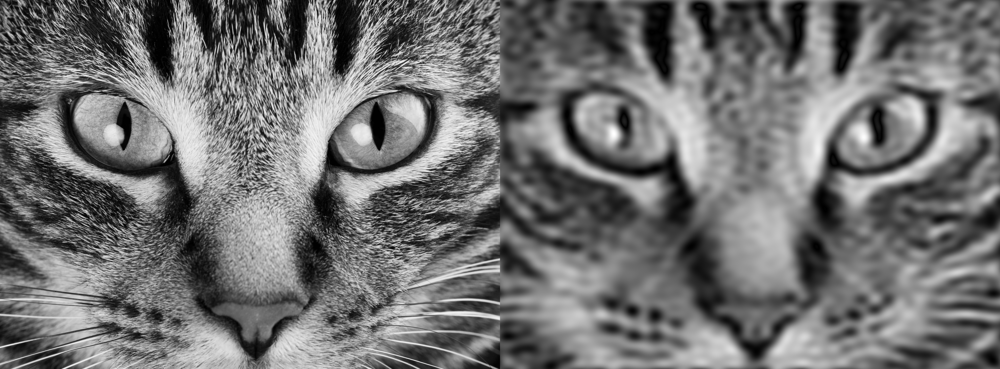

In [13]:
# lower pass
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load the image and convert it to grayscale
image = cv2.imread(r"cat.jpeg")
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Compute the discrete Fourier Transform of the image
fourier = cv2.dft(np.float32(gray), flags=cv2.DFT_COMPLEX_OUTPUT)

# Shift the zero-frequency component to the center of the spectrum
fourier_shift = np.fft.fftshift(fourier)

# Define the radius of the circular mask
radius = 30

# Create a circular mask with ones inside the circle and zeros outside
rows, cols = gray.shape
crow, ccol = rows // 2, cols // 2
mask = np.zeros((rows, cols, 2), np.uint8)
cv2.circle(mask, (ccol, crow), radius, (1, 1), -1)

# Apply the circular mask to the Fourier Transform
fourier_filtered = fourier_shift * mask

# Shift the zero-frequency component back to the top-left corner
fourier_filtered_shift = np.fft.ifftshift(fourier_filtered)

# Compute the inverse Fourier Transform to obtain the filtered image
filtered_image = cv2.idft(fourier_filtered_shift)
filtered_image = cv2.magnitude(filtered_image[:,:,0], filtered_image[:,:,1])

# Scale the filtered image for display
filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8UC1)

# Display the original image and the filtered image side by side
cv2_imshow(np.hstack([gray, filtered_image]))

